In [73]:
import pandas as pd
import numpy as np
import umap
from sklearn.decomposition import PCA

from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})
from mpl_toolkits.mplot3d import Axes3D

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_mutual_info_score as ads
from sklearn.metrics import normalized_mutual_info_score as nis
from sklearn.metrics import mutual_info_score as mis
from random import randint

import torch
from torch.utils.data import DataLoader
from Datasets import EmbeddedDataset, CDRH3
from Models import VaeEmb, VaeCdrh3

np.random.seed(42)

# Read the data

In [74]:
use_cuda = True
cpu_device = torch.device('cpu')
if torch.cuda.is_available() and use_cuda:
    device = torch.device('cuda:0')
    print('GPU device count:', torch.cuda.device_count())
else:
    device = torch.device('cpu')

print('Device in use: ', device)

GPU device count: 1
Device in use:  cuda:0


In [75]:
DATA_PATH = 'seq_repr.npz'
MODEL_PATH = 'vae_iter_1280-900-100-900-1280.pt'
DEVICE = 'cuda:0'  # change to 'cpu' if training on cpu

dataset = EmbeddedDataset(DATA_PATH, device=DEVICE)
data = DataLoader(dataset, batch_size=190_000, shuffle=True, num_workers=0,
                  drop_last=False, prefetch_factor=2)

model = VaeEmb.load(MODEL_PATH, device)

# get latent space from
with torch.no_grad():
    data_point, labels = next(iter(data))
    data_point = data_point.to(device)
    mu, _ = model.encode(data_point)
    latent = mu


In [76]:
n_samples = 50000
data = latent.data.cpu().numpy()
labels = np.array(labels)
data

array([[ 1.9482697e-03,  4.9026223e-04, -5.9301685e-05, ...,
         3.5835432e-03, -2.2648517e-03,  1.7559836e-03],
       [ 1.1459960e-03,  7.6949119e-04, -6.4217410e-04, ...,
         3.6746142e-03, -2.6826567e-03,  2.1298476e-03],
       [ 7.9753104e-04,  3.0847988e-04, -1.8483504e-04, ...,
         1.9112763e-03, -8.1790064e-04,  1.4488157e-03],
       ...,
       [-2.4413813e-03, -3.5655114e-04,  9.2049513e-04, ...,
        -3.9628614e-03,  1.2489171e-03, -7.2168442e-04],
       [-8.5309311e-04,  2.9507745e-04, -9.0463145e-04, ...,
        -4.1652941e-03,  2.2225971e-03, -2.8866257e-03],
       [ 6.9561630e-04,  3.7682409e-04, -8.6917181e-04, ...,
         6.6188525e-04, -9.4006170e-04, -1.2598794e-03]], dtype=float32)

In [77]:
labels

array(['Ag18', 'Ag44', 'Ag88', ..., 'Ag44', 'Ag126', 'Ag63'], dtype='<U5')

In [78]:
data.shape

(190000, 100)

In [79]:
labels.shape

(190000,)

In [80]:

idx = np.random.randint(len(data), size=n_samples)
data = data[idx]
labels = labels[idx]
# data = pd.DataFrame(data)
# labels = pd.DataFrame(label)

# rows = [randint(0, len(data)) for p in range(0, 10000)]

# data = data.iloc[rows,:].values
# data
# labels = labels.iloc[rows,:].values.ravel()

In [81]:
labels


array(['Ag91', 'Ag91', 'Ag126', ..., 'Ag18', 'Ag44', 'Ag98'], dtype='<U5')

In [82]:
data

array([[-0.00488324, -0.00140583,  0.0024725 , ..., -0.00899104,
         0.00431858, -0.00088045],
       [ 0.00139637,  0.00033072, -0.00046057, ...,  0.00275113,
        -0.00134383,  0.00017481],
       [-0.00444687, -0.00148499,  0.00342132, ..., -0.00662475,
         0.00300678,  0.00145214],
       ...,
       [ 0.00374643,  0.00011757, -0.00116467, ...,  0.00573552,
        -0.00202986, -0.00052151],
       [-0.00098643, -0.00079401,  0.00065828, ..., -0.00327915,
         0.00168877, -0.0016374 ],
       [ 0.00234477,  0.00157714, -0.00190928, ...,  0.00417218,
        -0.0013672 ,  0.00206093]], dtype=float32)

In [83]:
cmap = plt.get_cmap('viridis')
colors  = cmap(np.linspace(0, 1, len(labels)))

# Take a quick look at the data with UMAP

In [84]:
fit = umap.UMAP()
%time u = fit.fit_transform(data)

Wall time: 19.6 s


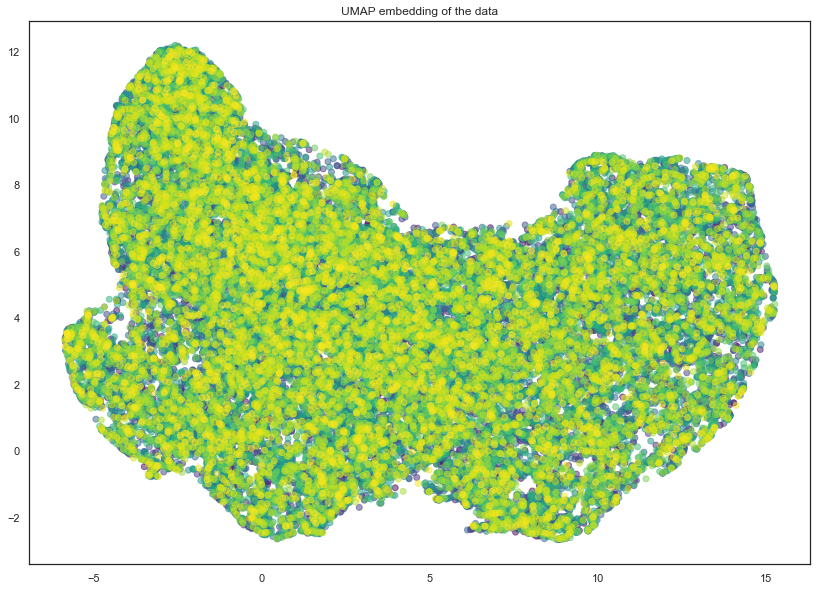

In [85]:
plt.scatter(u[:,0], u[:,1], c=colors, alpha=0.5)
plt.title('UMAP embedding of the data');

# Visualize the data with different parameters

In [86]:
all_metrics = {}

In [87]:
def calc_metrics(u, labels):

    # clustering
    kmeans = KMeans(n_clusters=10).fit(u)
    # eval clustering
    

    #for i in zip(np.array(labels), kmeans.labels_):
    #    print(i)
    
    return([ads(np.array(labels), kmeans.labels_), nis(np.array(labels), kmeans.labels_),
           mis(np.array(labels), kmeans.labels_)])

def draw_umap(n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean', title=''):
    fit = umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric
    )
    u = fit.fit_transform(data);
    fig = plt.figure()
    if n_components == 1:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], range(len(u)), c=colors,
            cmap=plt.get_cmap('tab10'), alpha=0.5)
    if n_components == 2:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], u[:,1], c=colors,
            cmap=plt.get_cmap('tab10'), alpha=0.5)
    if n_components == 3:
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(u[:,0], u[:,1], u[:,2], c=colors,
            cmap=plt.get_cmap('tab10'), alpha=0.5, s=100)
    plt.title(title, fontsize=18)
    all_metrics[str(n_neighbors), str(min_dist), str(n_components), str(metric)] = calc_metrics(u, labels)
    

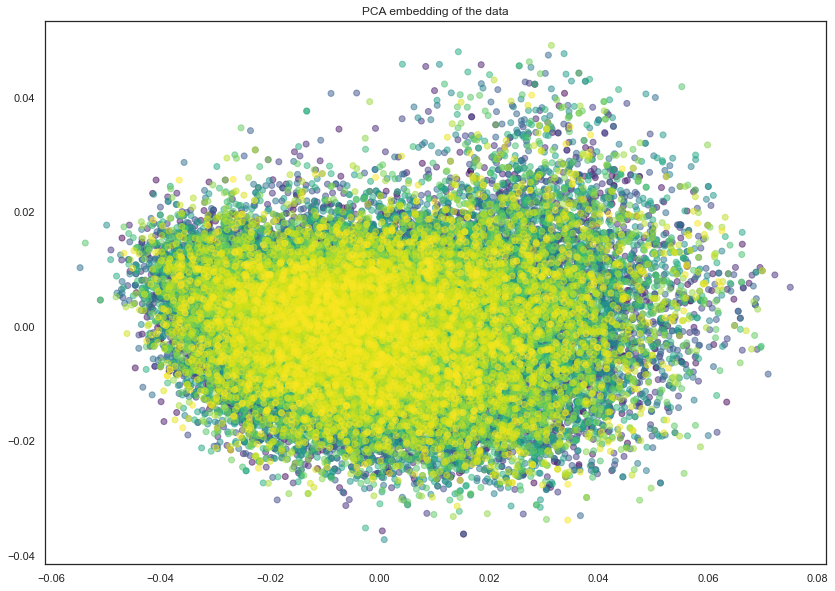

In [88]:
pca = PCA(n_components=2)
x = pca.fit_transform(data)
plt.scatter(x[:,0], x[:,1], c=colors,
            cmap=plt.get_cmap('tab10'), alpha=0.5)
plt.title('PCA embedding of the data');

all_metrics[str("PCA"), str("PCA"), str("PCA"), str("PCA")] = calc_metrics(x, labels)

In [89]:
for n in (2, 5, 10, 20, 50, 100, 200):
    print(n)
    draw_umap(n_neighbors=n, title='n_neighbors = {}'.format(n))

2


MemoryError: Unable to allocate 1.35 GiB for an array with shape (13454, 13454) and data type float64

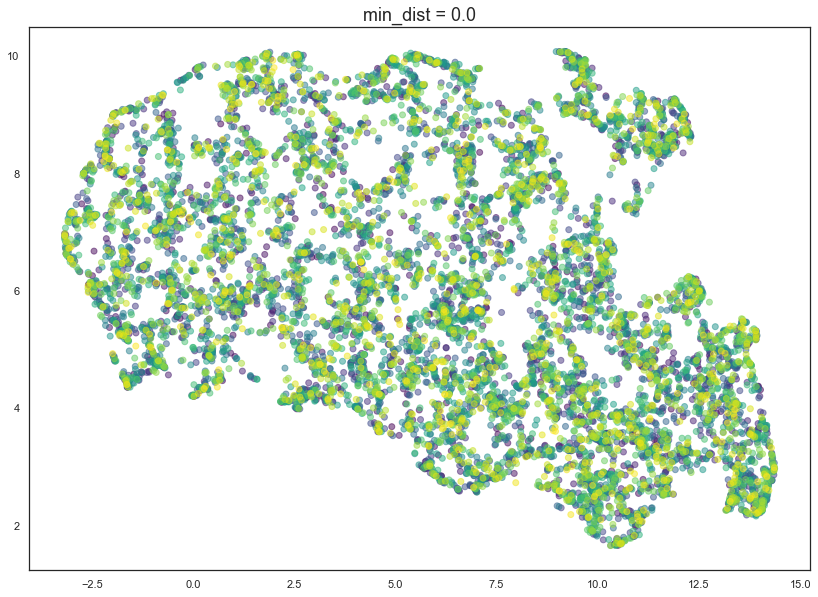

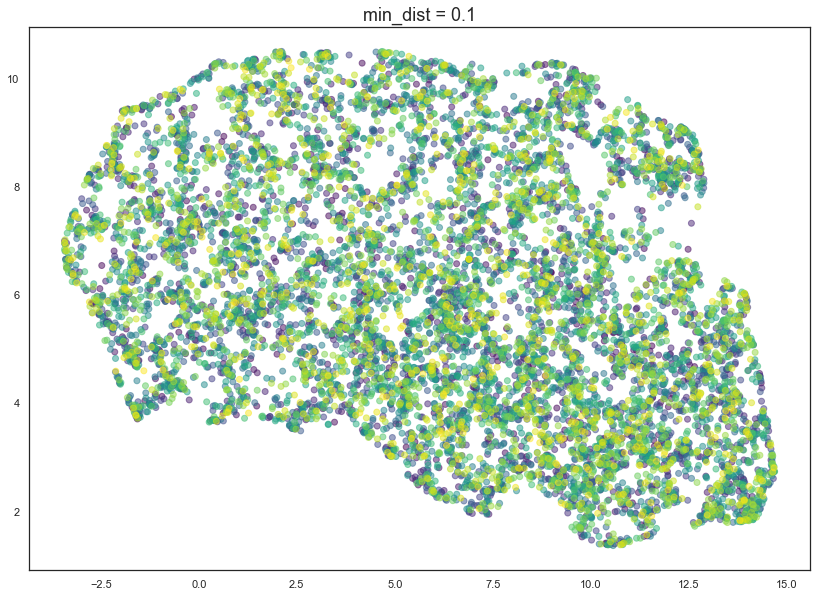

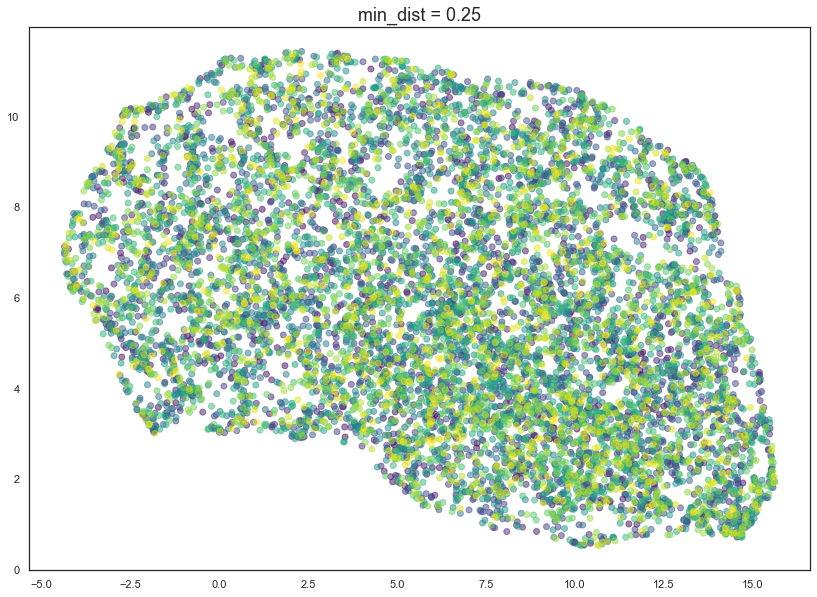

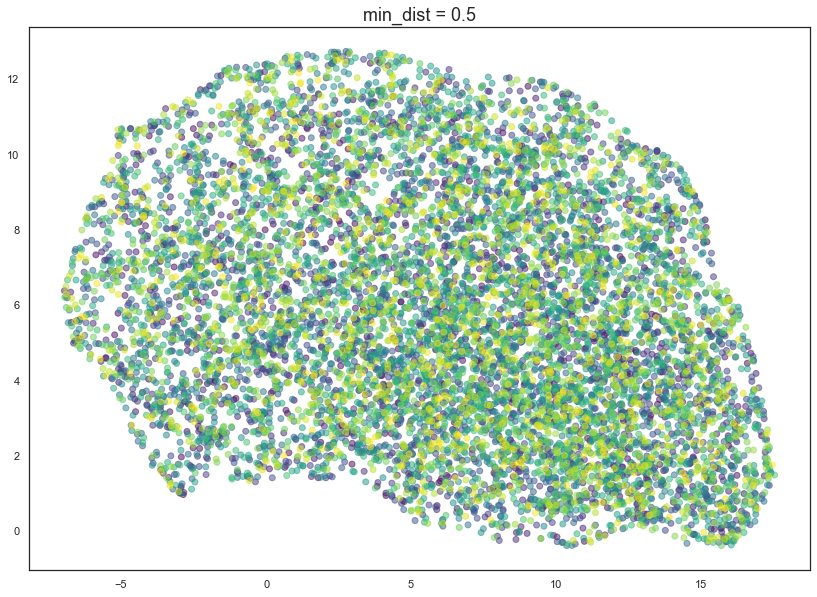

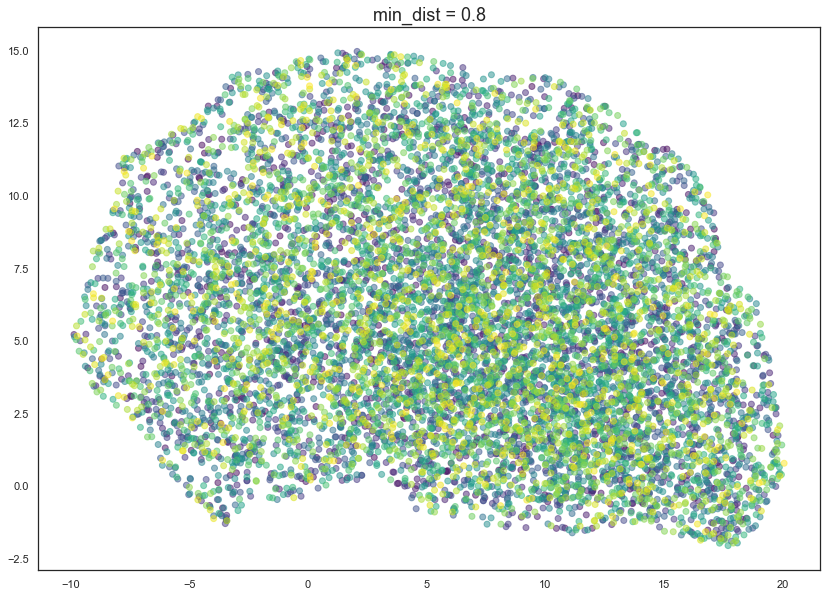

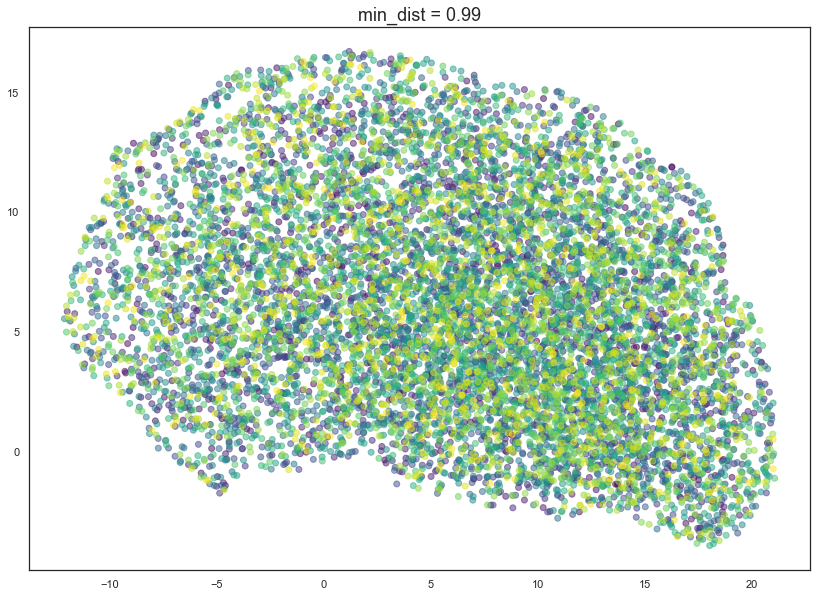

In [43]:
for d in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
    draw_umap(min_dist=d, title='min_dist = {}'.format(d))

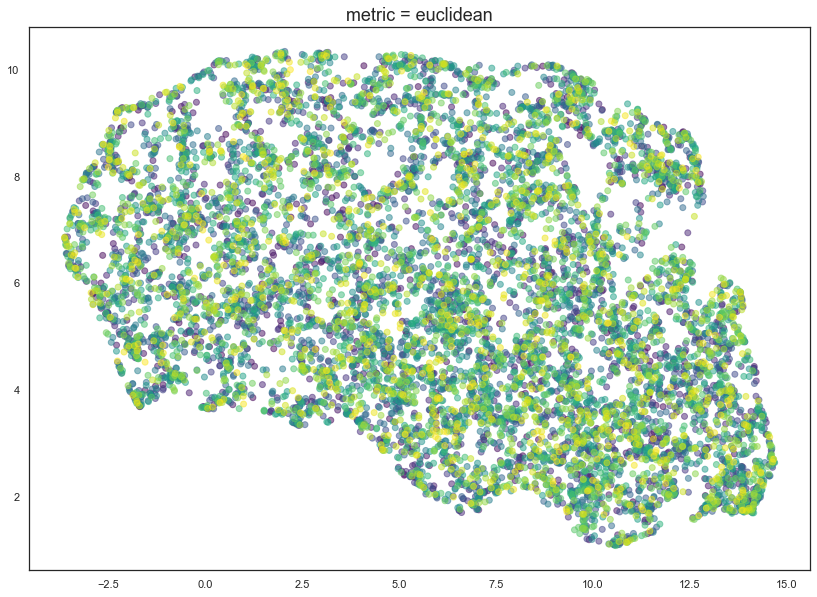

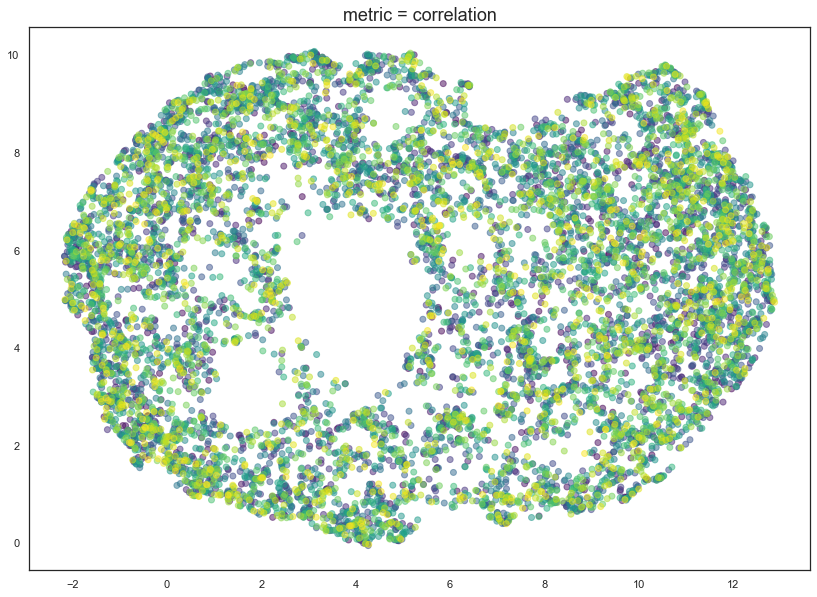

In [44]:
for m in ("euclidean", "correlation"):
    name = m if type(m) is str else m.__name__
    draw_umap(n_components=2, metric=m, title='metric = {}'.format(name))

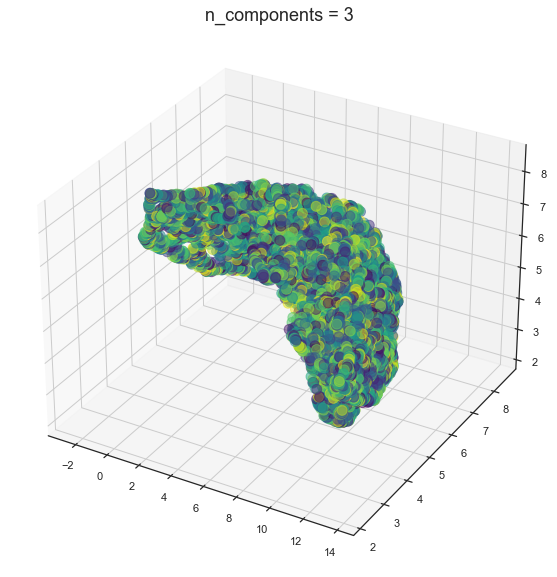

In [45]:
draw_umap(n_components=3, title='n_components = 3')

In [46]:
all_metrics = pd.DataFrame(all_metrics).T
all_metrics.columns = ["adjusted_mutual_info_score", "normalized_mutual_info_score", "mutual_info_score"]

In [47]:
all_metrics


adjusted_mutual_info_score  \
PCA PCA  PCA PCA                            0.033169   
2   0.1  2   euclidean                      0.016722   
5   0.1  2   euclidean                      0.038535   
10  0.1  2   euclidean                      0.038224   
20  0.1  2   euclidean                      0.033460   
50  0.1  2   euclidean                      0.033407   
100 0.1  2   euclidean                      0.033346   
200 0.1  2   euclidean                      0.033283   
15  0.0  2   euclidean                      0.037207   
    0.1  2   euclidean                      0.036392   
    0.25 2   euclidean                      0.032945   
    0.5  2   euclidean                      0.032121   
    0.8  2   euclidean                      0.033614   
    0.99 2   euclidean                      0.033775   
    0.1  2   correlation                    0.035527   
         3   euclidean                      0.033335   

                          normalized_mutual_info_score  mutual_info_score  
PCA PCA  PCA PCA                              0.034931           0.077852  
2   0.1  2   euclidean                        0.018474           0.042072  
5   0.1  2   euclidean                        0.040252           0.091470  
10  0.1  2   euclidean                        0.039940           0.090877  
20  0.1  2   euclidean                        0.035187           0.079927  
50  0.1  2   euclidean                        0.035134           0.079842  
100 0.1  2   euclidean                        0.035072           0.079748  
200 0.1  2   euclidean                        0.035009           0.079595  
15  0.0  2   euclidean                        0.038923           0.088614  
    0.1  2   euclidean                        0.038110           0.086729  
    0.25 2   euclidean                        0.034670           0.078883  
    0.5  2   euclidean                        0.033845           0.077110  
    0.8  2   euclidean                        0.035337           0.080475  
    0.99 2   euclidean                        0.035497           0.080850  
    0.1  2   correlation                      0.037244           0.084913  
         3   euclidean                        0.035063           0.079625

# Visualize the metrics